# Install detectron2

In [70]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities.
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

print("Done!")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 KB 17.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp39-cp39-linux_x86_64.whl size=44090 sha256=468ffdd67240c2b878ec4e5ef9a4099f35c34cbc11c5515ec2e817140e4839a2
  Stored in directory: /root/.cache/pip/wheels/68/be/8f/b6c454cd264e0b349b47f8ee00755511f277618af9e5dae20d
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0
    Uninstalling PyYAML-6.0:
      Successfully uninstalled PyYAML-6.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
ultralytics 8.0.52 requires PyYAML>=5.3.1, but you have pyyaml 5.1 which is incompatible.
roboflow 0.2.32 requires PyYAML>=5.3.1, but you have pyyaml 5.1 which is inco

In [71]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  1.13 ; cuda:  cu116
detectron2: 0.6


In [72]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

In [73]:
!nvidia-smi

Fri Mar 10 16:44:19 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   74C    P0    30W /  70W |   1909MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------


## Prepare the dataset


In [74]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="FlkxEvR1HdCJepitvMdT")
project = rf.workspace("innopolis-university-cpdrw").project("guyfoxmask-glasses")
dataset = project.version(2).download("coco")


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 661.8/661.8 KB 36.2 MB/s eta 0:00:00
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 5.1
    Uninstalling PyYAML-5.1:
      Successfully uninstalled PyYAML-5.1


loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to GuyFoxMask-Glasses-2 in coco:: 100%|██████████| 100/100 [00:00<00:00, 1617.32it/s]


Registrating Train, Test, Validation datasets. 

In [86]:
# if your dataset is in COCO format, this cell can be replaced by the following three lines:
from detectron2.data.datasets import register_coco_instances, convert_to_coco_json
from detectron2.data import DatasetCatalog, MetadataCatalog

print(os.path.join(dataset.location, "train", "_annotations.coco.json"))
dataset_name1 = 'GuyFoxMask-Glasses_train'
dataset_name2 = 'GuyFoxMask-Glasses_val' 
dataset_name3 = 'GuyFoxMask-Glasses_test' 
if dataset_name1 in DatasetCatalog.list():
  DatasetCatalog.remove(dataset_name1)
  MetadataCatalog.remove(dataset_name1)
if dataset_name2 in DatasetCatalog.list(): 
  DatasetCatalog.remove(dataset_name2)
  MetadataCatalog.remove(dataset_name2)
if dataset_name3 in DatasetCatalog.list():
  DatasetCatalog.remove(dataset_name3)
  MetadataCatalog.remove(dataset_name3)
print(MetadataCatalog)
try:
  register_coco_instances("GuyFoxMask-Glasses_train", 
                          {}, 
                          os.path.join(dataset.location, "train", "_annotations.coco.json"), 
                          "/content/GuyFoxMask-Glasses-2/train")
  register_coco_instances("GuyFoxMask-Glasses_val", 
                          {}, 
                          os.path.join(dataset.location, "valid", "_annotations.coco.json"), 
                          "/content/GuyFoxMask-Glasses-2/valid")
  register_coco_instances("GuyFoxMask-Glasses_test", 
                          {}, 
                          os.path.join(dataset.location, "test", "_annotations.coco.json"), 
                          "/content/GuyFoxMask-Glasses-2/test")
except Exception as error:
  print(error)

/content/GuyFoxMask-Glasses-2/train/_annotations.coco.json
MetadataCatalog(registered metadata: coco_2014_train, coco_2014_val, coco_2014_minival, coco_2014_valminusminival, coco_2017_train, coco_2017_val, coco_2017_test, coco_2017_test-dev, coco_2017_val_100, keypoints_coco_2014_train, keypoints_coco_2014_val, keypoints_coco_2014_minival, keypoints_coco_2014_valminusminival, keypoints_coco_2017_train, keypoints_coco_2017_val, keypoints_coco_2017_val_100, coco_2017_train_panoptic_separated, coco_2017_train_panoptic_stuffonly, coco_2017_train_panoptic, coco_2017_val_panoptic_separated, coco_2017_val_panoptic_stuffonly, coco_2017_val_panoptic, coco_2017_val_100_panoptic_separated, coco_2017_val_100_panoptic_stuffonly, coco_2017_val_100_panoptic, lvis_v1_train, lvis_v1_val, lvis_v1_test_dev, lvis_v1_test_challenge, lvis_v0.5_train, lvis_v0.5_val, lvis_v0.5_val_rand_100, lvis_v0.5_test, lvis_v0.5_train_cocofied, lvis_v0.5_val_cocofied, cityscapes_fine_instance_seg_train, cityscapes_fine_se

In [87]:
print(DatasetCatalog)

DatasetCatalog(registered datasets: coco_2014_train, coco_2014_val, coco_2014_minival, coco_2014_valminusminival, coco_2017_train, coco_2017_val, coco_2017_test, coco_2017_test-dev, coco_2017_val_100, keypoints_coco_2014_train, keypoints_coco_2014_val, keypoints_coco_2014_minival, keypoints_coco_2014_valminusminival, keypoints_coco_2017_train, keypoints_coco_2017_val, keypoints_coco_2017_val_100, coco_2017_train_panoptic_separated, coco_2017_train_panoptic_stuffonly, coco_2017_train_panoptic, coco_2017_val_panoptic_separated, coco_2017_val_panoptic_stuffonly, coco_2017_val_panoptic, coco_2017_val_100_panoptic_separated, coco_2017_val_100_panoptic_stuffonly, coco_2017_val_100_panoptic, lvis_v1_train, lvis_v1_val, lvis_v1_test_dev, lvis_v1_test_challenge, lvis_v0.5_train, lvis_v0.5_val, lvis_v0.5_val_rand_100, lvis_v0.5_test, lvis_v0.5_train_cocofied, lvis_v0.5_val_cocofied, cityscapes_fine_instance_seg_train, cityscapes_fine_sem_seg_train, cityscapes_fine_instance_seg_val, cityscapes_fi

To verify the dataset is in correct format, let's visualize the annotations of randomly selected samples in the training set:



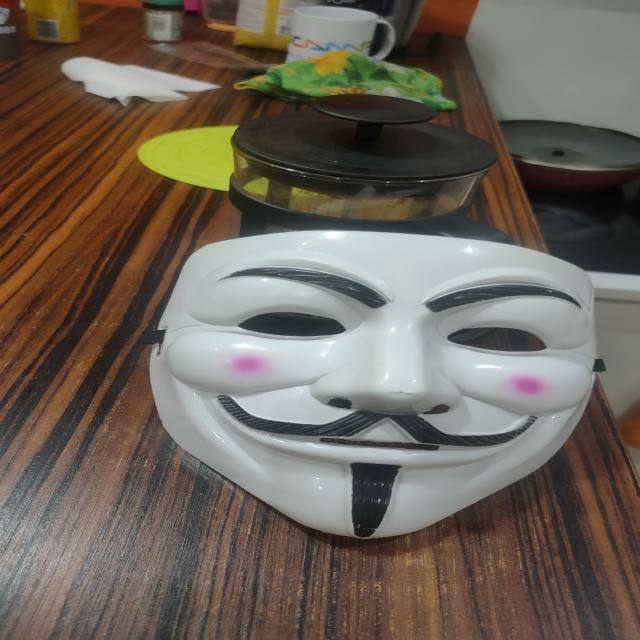

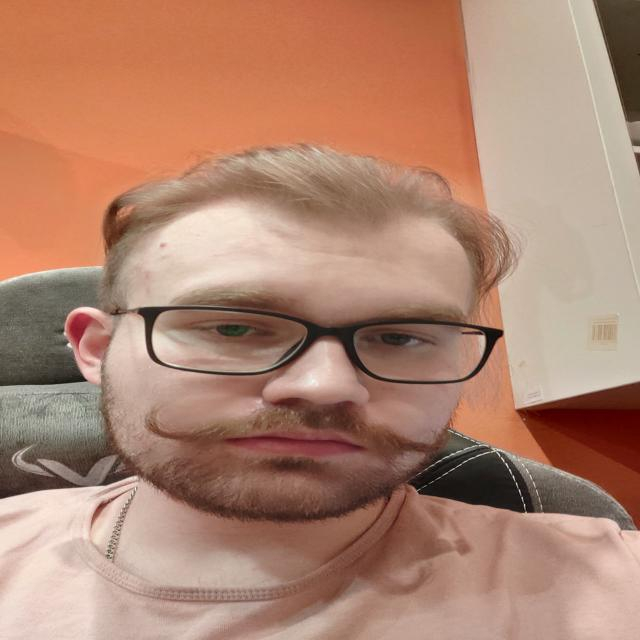

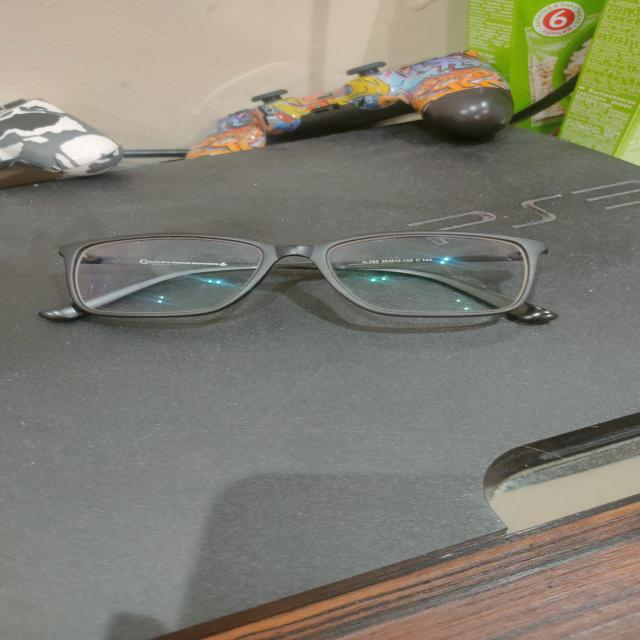

In [88]:
def get_dicts(dir):
  paths = os.listdir(dir)
  dataset_dicts = []
  for path in paths:
    dataset_dicts.append({"file_name": path})
  return dataset_dicts
from google.colab.patches import cv2_imshow
dataset_train_path = "GuyFoxMask-Glasses-2/train"
dataset_dicts = get_dicts(dataset_train_path)
for d in random.sample(dataset_dicts, 3):
    f"{dataset_train_path}/"+d["file_name"]
    img = cv2.imread(f"{dataset_train_path}/"+d["file_name"])
    cv2_imshow(img)
    visualizer = Visualizer(img[:, :, ::-1], scale=0.5)
    out = visualizer.draw_dataset_dict(d)


## Train!

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the balloon dataset. It takes ~2 minutes to train 300 iterations on a P100 GPU.


In [89]:
from detectron2.engine import DefaultTrainer

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("GuyFoxMask-Glasses_train",)
cfg.DATASETS.TEST = ("GuyFoxMask-Glasses_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 6  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 600    # 300 iterations seems good enough for this toy dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 256   # The "RoIHead batch size". 128 is faster, and good enough for this toy dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # only has one class (ballon). (see https://detectron2.readthedocs.io/tutorials/datasets.html#update-the-config-for-new-datasets)
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg) 
trainer.resume_or_load(resume=False)
trainer.train()


[03/10 16:50:09 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_280758.pkl: 167MB [00:04, 39.6MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}


[03/10 16:50:14 d2.engine.train_loop]: Starting training from iteration 0
[03/10 16:50:42 d2.utils.events]:  eta: 0:13:39  iter: 19  total_loss: 1.646  loss_cls: 1.315  loss_box_reg: 0.3207  loss_rpn_cls: 0.01027  loss_rpn_loc: 0.01026  time: 1.3819  last_time: 1.4113  data_time: 0.0815  last_data_time: 0.0537   lr: 8.1588e-06  max_mem: 3896M
[03/10 16:51:09 d2.utils.events]:  eta: 0:13:03  iter: 39  total_loss: 1.439  loss_cls: 1.116  loss_box_reg: 0.2987  loss_rpn_cls: 0.01145  loss_rpn_loc: 0.01119  time: 1.3718  last_time: 1.1967  data_time: 0.0694  last_data_time: 0.0581   lr: 1.6484e-05  max_mem: 3896M
[03/10 16:51:37 d2.utils.events]:  eta: 0:12:29  iter: 59  total_loss: 1.147  loss_cls: 0.7917  loss_box_reg: 0.3238  loss_rpn_cls: 0.009127  loss_rpn_loc: 0.01092  time: 1.3747  last_time: 1.3824  data_time: 0.0752  last_data_time: 0.0560   lr: 2.4809e-05  max_mem: 3896M
[03/10 16:52:04 d2.utils.events]:  eta: 0:12:02  iter: 79  total_loss: 0.8887  loss_cls: 0.5255  loss_box_reg: 

In [90]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained:



In [91]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85 
predictor = DefaultPredictor(cfg)

[03/10 17:06:15 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


Then, we randomly select several samples to visualize the prediction results.

IMG20230306192726_jpg.rf.3350c113293db86c0ac2d6eff780a1e4.jpg


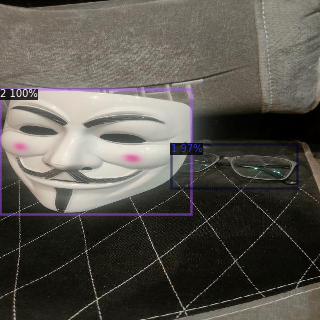

IMG20230306192600_jpg.rf.1a7695136c2c76c0c227812d7d312c38.jpg


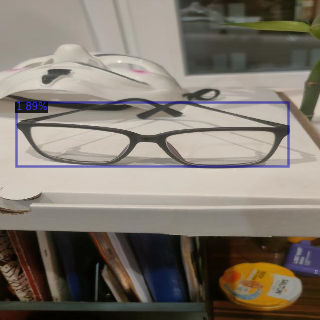

IMG20230306193153_jpg.rf.abcdafa94aaae510b792dd763f96f4b4.jpg


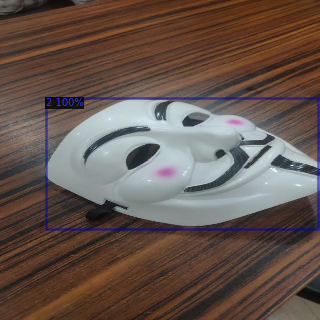

In [93]:
from detectron2.utils.visualizer import ColorMode

def get_dicts(dir):
  paths = os.listdir(dir)
  dataset_dicts = []
  for path in paths:
    dataset_dicts.append({"file_name": path})
  return dataset_dicts

from google.colab.patches import cv2_imshow
dataset_train_path = "GuyFoxMask-Glasses-2/test"
dataset_dicts = get_dicts(dataset_train_path)
for d in random.sample(dataset_dicts, 3):  
    if "_annotations.coco.json" == d["file_name"]:
      continue
    print(d["file_name"])
    im = cv2.imread(f"{dataset_train_path}/" + d["file_name"])
    outputs = predictor(im) 
    v = Visualizer(im[:, :, ::-1],
                   scale=0.5
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [94]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("GuyFoxMask-Glasses_test", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "GuyFoxMask-Glasses_test")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

[03/10 17:07:45 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [03/10 17:07:45 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[03/10 17:07:45 d2.data.datasets.coco]: Loaded 11 images in COCO format from /content/GuyFoxMask-Glasses-2/test/_annotations.coco.json
[03/10 17:07:45 d2.data.build]: Distribution of instances among all 3 categories:
|   category    | #instances   |  category  | #instances   |  category  | #instances   |
|:-------------:|:-------------|:----------:|:-------------|:----------:|:-------------|
| GayFoxMask-.. | 0            |  Glasses   | 7            | GuyFoxMask | 6            |
|               |              |            |              |            |              |
|     total     | 13           |            |              |            |              |
[03/10 17:07:45 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inferenc

In [ ]:
!pip install ultralytics
print()

In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="FlkxEvR1HdCJepitvMdT")
project = rf.workspace("innopolis-university-cpdrw").project("guyfoxmask-glasses")
dataset = project.version(2).download("yolov8")


In [17]:
from shutil import move

f = open("/content/GuyFoxMask-Glasses-2/data.yaml", 'w')
f.write("""names:
- Glasses
- GuyFoxMask
nc: 2
roboflow:
  license: CC BY 4.0
  project: guyfoxmask-glasses
  url: https://universe.roboflow.com/innopolis-university-cpdrw/guyfoxmask-glasses/dataset/2
  version: 2
  workspace: innopolis-university-cpdrw
test: ../test/images
train: ../train/images
val: ../valid/images
""")
f.close()

In [35]:
from ultralytics import YOLO

model = YOLO('yolov8n.pt')
results = model.train(
   data='/content/GuyFoxMask-Glasses-2/data.yaml',
   imgsz=640,
   epochs=64,
   batch=16,
   name='yolov8n_GuyFoxMask_Glasses')

Ultralytics YOLOv8.0.52 🚀 Python-3.9.16 torch-1.13.1+cu116 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/GuyFoxMask-Glasses-2/data.yaml, epochs=64, patience=50, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8n_GuyFoxMask_Glasses, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False, optimize=False,

In [24]:
from ultralytics import YOLO
import os
from google.colab.patches import cv2_imshow
from cv2 import imread

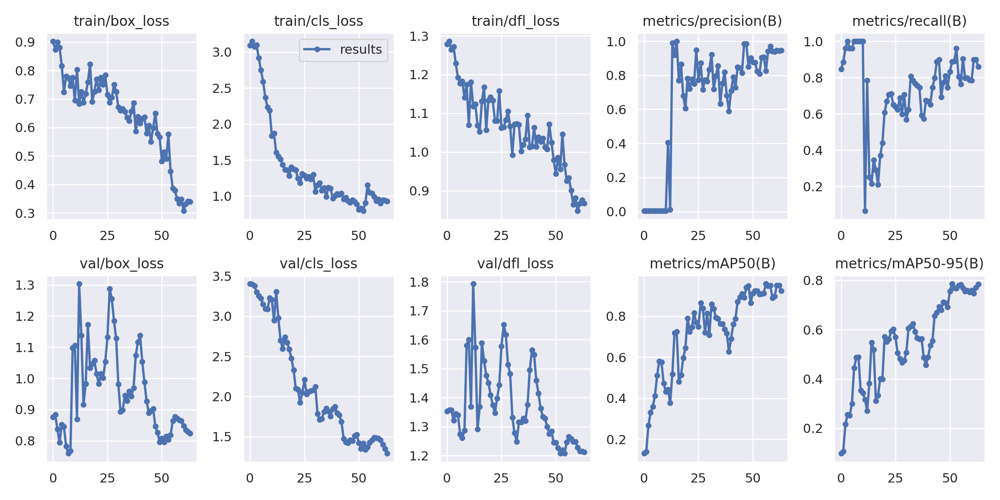

In [36]:
im = imread("runs/detect/yolov8n_GuyFoxMask_Glasses12/results.png")
cv2_imshow(im)

In [43]:
success = model.export(format="onnx")

Ultralytics YOLOv8.0.52 🚀 Python-3.9.16 torch-1.13.1+cu116 CPU

PyTorch: starting from runs/detect/yolov8n_GuyFoxMask_Glasses11/weights/best.pt with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 6, 8400) (5.9 MB)

ONNX: starting export with onnx 1.13.1...
ONNX: export success ✅ 1.8s, saved as runs/detect/yolov8n_GuyFoxMask_Glasses11/weights/best.onnx (11.7 MB)

Export complete (2.4s)
Results saved to /content/runs/detect/yolov8n_GuyFoxMask_Glasses11/weights
Predict:         yolo predict task=detect model=runs/detect/yolov8n_GuyFoxMask_Glasses11/weights/best.onnx imgsz=640 
Validate:        yolo val task=detect model=runs/detect/yolov8n_GuyFoxMask_Glasses11/weights/best.onnx imgsz=640 data=/content/GuyFoxMask-Glasses-2/data.yaml 
Visualize:       https://netron.app


In [48]:
import cv2
def box_label(image, box, label='', color=(128, 128, 128), txt_color=(255, 255, 255)):
  lw = max(round(sum(image.shape) / 2 * 0.003), 2)
  p1, p2 = (int(box[0]), int(box[1])), (int(box[2]), int(box[3]))
  cv2.rectangle(image, p1, p2, color, thickness=lw, lineType=cv2.LINE_AA)
  if label:
    tf = max(lw - 1, 1)  # font thickness
    w, h = cv2.getTextSize(label, 0, fontScale=lw / 3, thickness=tf)[0]  # text width, height
    outside = p1[1] - h >= 3
    p2 = p1[0] + w, p1[1] - h - 3 if outside else p1[1] + h + 3
    cv2.rectangle(image, p1, p2, color, -1, cv2.LINE_AA)  # filled
    cv2.putText(image,
                label, (p1[0], p1[1] - 2 if outside else p1[1] + h + 2),
                0,
                lw / 3,
                txt_color,
                thickness=tf,
                lineType=cv2.LINE_AA)
    

def plot_bboxes(image, boxes, labels=[], colors=[], score=True, conf=None):
  
  #Define COCO Labels
  if labels == []:
    labels = {0:u'__background__', 1: u'Glasses', 2: u'GuyFoxMask'}
  #Define colors
  if colors == []:
    #colors = [(6, 112, 83), (253, 246, 160), (40, 132, 70), (205, 97, 162), (149, 196, 30), (106, 19, 161), (127, 175, 225), (115, 133, 176), (83, 156, 8), (182, 29, 77), (180, 11, 251), (31, 12, 123), (23, 6, 115), (167, 34, 31), (176, 216, 69), (110, 229, 222), (72, 183, 159), (90, 168, 209), (195, 4, 209), (135, 236, 21), (62, 209, 199), (87, 1, 70), (75, 40, 168), (121, 90, 126), (11, 86, 86), (40, 218, 53), (234, 76, 20), (129, 174, 192), (13, 18, 254), (45, 183, 149), (77, 234, 120), (182, 83, 207), (172, 138, 252), (201, 7, 159), (147, 240, 17), (134, 19, 233), (202, 61, 206), (177, 253, 26), (10, 139, 17), (130, 148, 106), (174, 197, 128), (106, 59, 168), (124, 180, 83), (78, 169, 4), (26, 79, 176), (185, 149, 150), (165, 253, 206), (220, 87, 0), (72, 22, 226), (64, 174, 4), (245, 131, 96), (35, 217, 142), (89, 86, 32), (80, 56, 196), (222, 136, 159), (145, 6, 219), (143, 132, 162), (175, 97, 221), (72, 3, 79), (196, 184, 237), (18, 210, 116), (8, 185, 81), (99, 181, 254), (9, 127, 123), (140, 94, 215), (39, 229, 121), (230, 51, 96), (84, 225, 33), (218, 202, 139), (129, 223, 182), (167, 46, 157), (15, 252, 5), (128, 103, 203), (197, 223, 199), (19, 238, 181), (64, 142, 167), (12, 203, 242), (69, 21, 41), (177, 184, 2), (35, 97, 56), (241, 22, 161)]
    colors = [(89, 161, 197),(67, 161, 255),(19, 222, 24),(186, 55, 2),(167, 146, 11),(190, 76, 98),(130, 172, 179),(115, 209, 128),(204, 79, 135),(136, 126, 185),(209, 213, 45),(44, 52, 10),(101, 158, 121),(179, 124, 12),(25, 33, 189),(45, 115, 11),(73, 197, 184),(62, 225, 221),(32, 46, 52),(20, 165, 16),(54, 15, 57),(12, 150, 9),(10, 46, 99),(94, 89, 46),(48, 37, 106),(42, 10, 96),(7, 164, 128),(98, 213, 120),(40, 5, 219),(54, 25, 150),(251, 74, 172),(0, 236, 196),(21, 104, 190),(226, 74, 232),(120, 67, 25),(191, 106, 197),(8, 15, 134),(21, 2, 1),(142, 63, 109),(133, 148, 146),(187, 77, 253),(155, 22, 122),(218, 130, 77),(164, 102, 79),(43, 152, 125),(185, 124, 151),(95, 159, 238),(128, 89, 85),(228, 6, 60),(6, 41, 210),(11, 1, 133),(30, 96, 58),(230, 136, 109),(126, 45, 174),(164, 63, 165),(32, 111, 29),(232, 40, 70),(55, 31, 198),(148, 211, 129),(10, 186, 211),(181, 201, 94),(55, 35, 92),(129, 140, 233),(70, 250, 116),(61, 209, 152),(216, 21, 138),(100, 0, 176),(3, 42, 70),(151, 13, 44),(216, 102, 88),(125, 216, 93),(171, 236, 47),(253, 127, 103),(205, 137, 244),(193, 137, 224),(36, 152, 214),(17, 50, 238),(154, 165, 67),(114, 129, 60),(119, 24, 48),(73, 8, 110)]
  
  #plot each boxes
  for box in boxes:
    #add score in label if score=True
    if score :
      label = labels[int(box[-1])+1] + " " + str(round(100 * float(box[-2]),1)) + "%"
    else :
      label = labels[int(box[-1])+1]
    #filter every box under conf threshold if conf threshold setted
    if conf :
      if box[-2] > conf:
        color = colors[int(box[-1])]
        box_label(image, box, label, color)
    else:
      color = colors[int(box[-1])]
      box_label(image, box, label, color)

  #show image
  image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

  try:
    import google.colab
    IN_COLAB = True
  except:
    IN_COLAB = False

  if IN_COLAB:
    cv2_imshow(image) #if used in Colab
  else :
    cv2.imshow(image) #if used in Python


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306193233_jpg.rf.a1f105bdd6c5c207122d1487b5d15ce7.jpg: 640x640 1 GuyFoxMask, 30.3ms
Speed: 0.6ms preprocess, 30.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


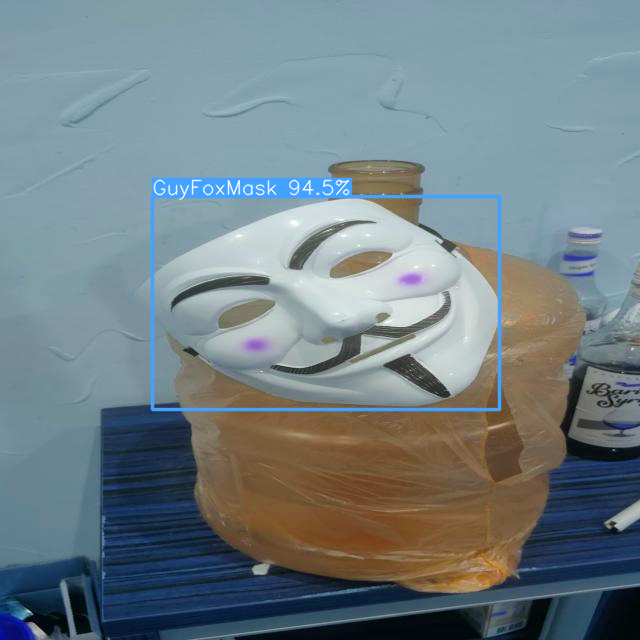


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306193153_jpg.rf.abcdafa94aaae510b792dd763f96f4b4.jpg: 640x640 1 GuyFoxMask, 19.0ms
Speed: 0.6ms preprocess, 19.0ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


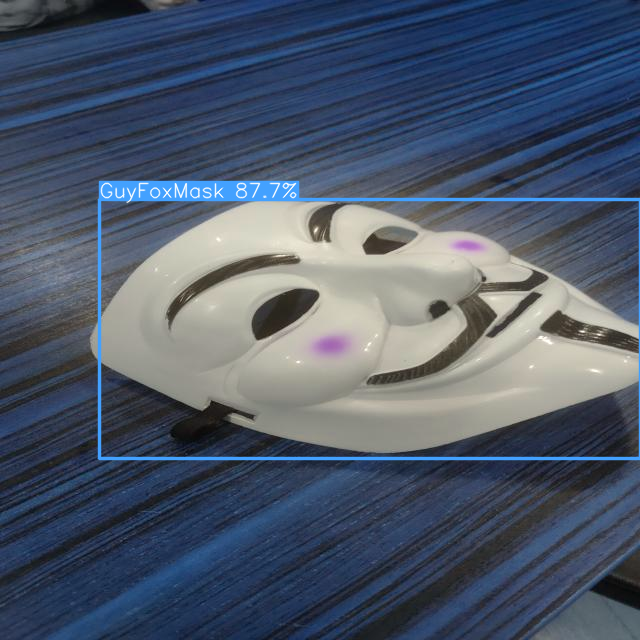


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306141719_jpg.rf.550b2d2b5bd0fa9a7ed1894eb01625c8.jpg: 640x640 3 Glassess, 17.7ms
Speed: 0.6ms preprocess, 17.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)


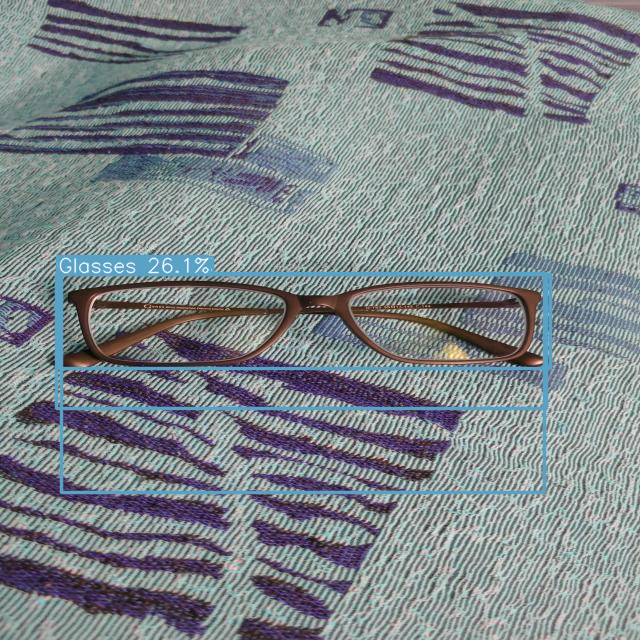


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306142117_jpg.rf.3f2ffa97b605f4629065c514783ed5e0.jpg: 640x640 1 Glasses, 1 GuyFoxMask, 28.3ms
Speed: 5.7ms preprocess, 28.3ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


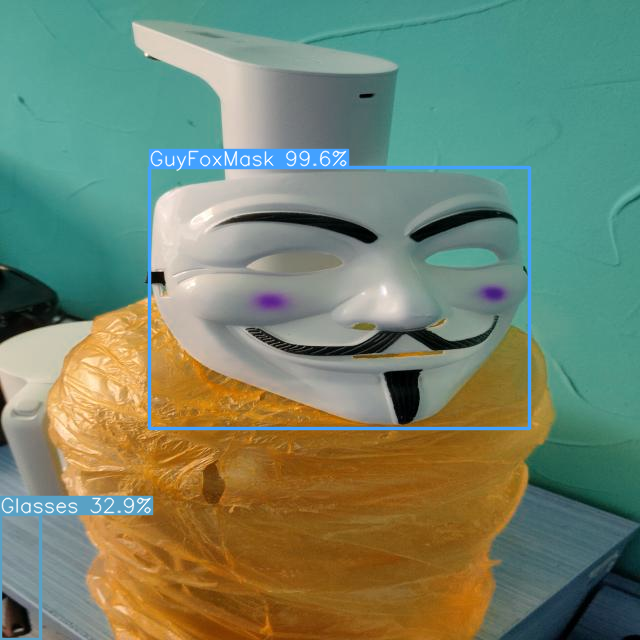


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306192600_jpg.rf.1a7695136c2c76c0c227812d7d312c38.jpg: 640x640 1 Glasses, 2 GuyFoxMasks, 25.5ms
Speed: 0.7ms preprocess, 25.5ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


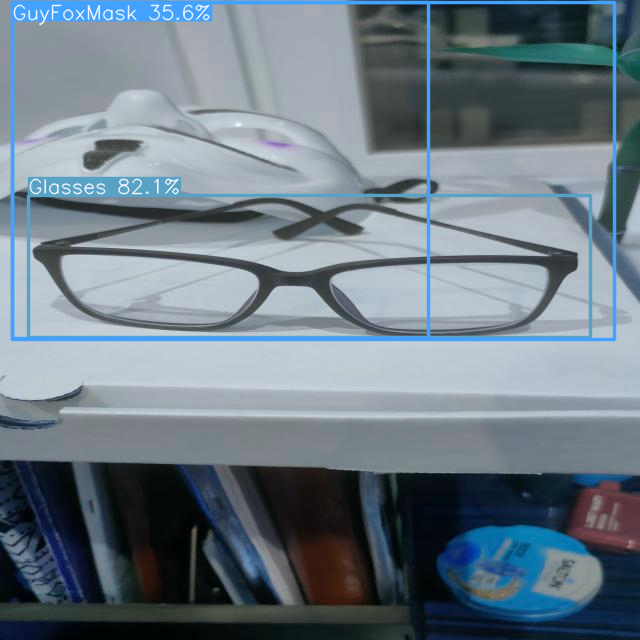


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306202012_jpg.rf.98291b5a125c0b50b0a2ad0dae67125f.jpg: 640x640 1 Glasses, 1 GuyFoxMask, 23.4ms
Speed: 0.6ms preprocess, 23.4ms inference, 2.5ms postprocess per image at shape (1, 3, 640, 640)


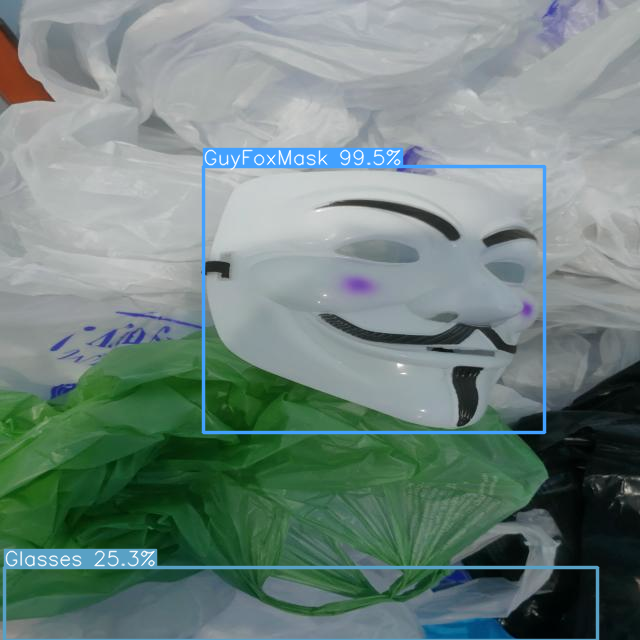


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306192900_jpg.rf.d6ea074ef39e060234a8acf3fba1401c.jpg: 640x640 1 Glasses, 1 GuyFoxMask, 23.9ms
Speed: 0.7ms preprocess, 23.9ms inference, 4.3ms postprocess per image at shape (1, 3, 640, 640)


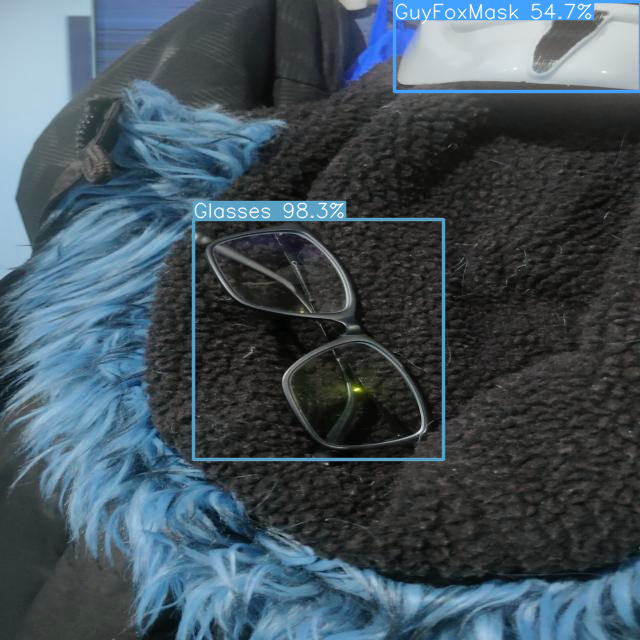


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306201637_jpg.rf.3454662671330f806ce9dbbc45d8c0f1.jpg: 640x640 1 GuyFoxMask, 28.6ms
Speed: 0.7ms preprocess, 28.6ms inference, 4.5ms postprocess per image at shape (1, 3, 640, 640)


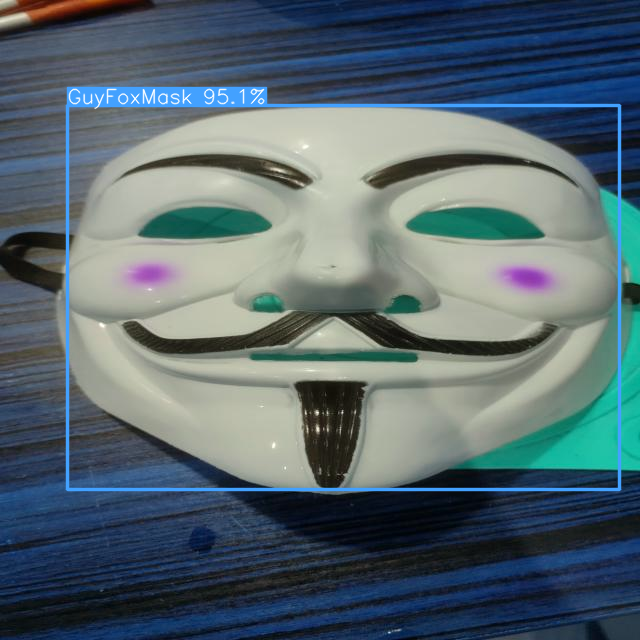


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306201327_jpg.rf.cdbc65390ee8563ac0e757366caabe42.jpg: 640x640 1 Glasses, 22.9ms
Speed: 0.6ms preprocess, 22.9ms inference, 2.3ms postprocess per image at shape (1, 3, 640, 640)


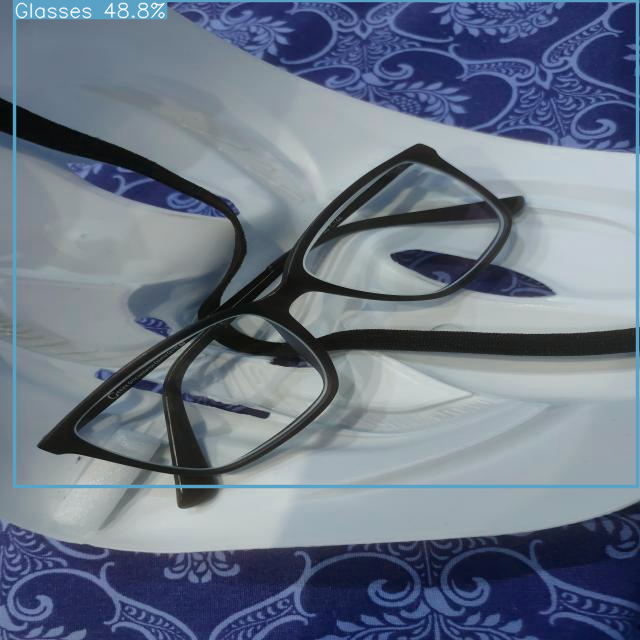


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306192913_jpg.rf.22854ce3e5661dae4963a5b7994bdde1.jpg: 640x640 1 Glasses, 27.4ms
Speed: 0.6ms preprocess, 27.4ms inference, 6.1ms postprocess per image at shape (1, 3, 640, 640)


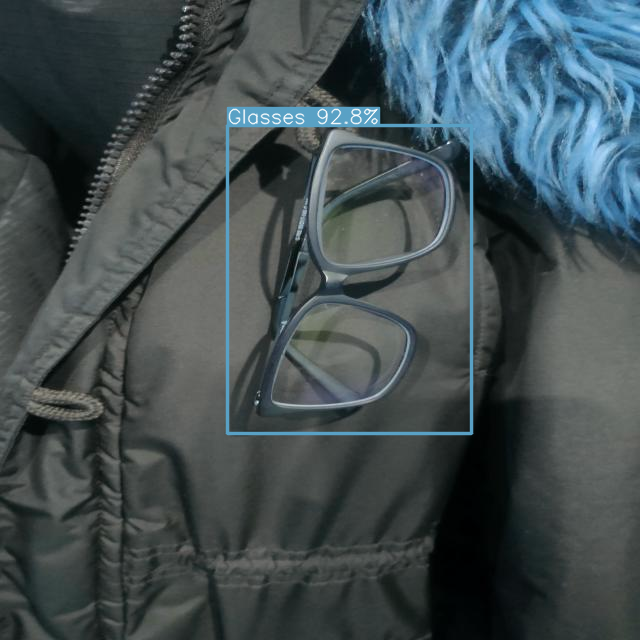


image 1/1 /content/GuyFoxMask-Glasses-2/test/images/IMG20230306192726_jpg.rf.3350c113293db86c0ac2d6eff780a1e4.jpg: 640x640 1 GuyFoxMask, 24.2ms
Speed: 3.8ms preprocess, 24.2ms inference, 5.5ms postprocess per image at shape (1, 3, 640, 640)


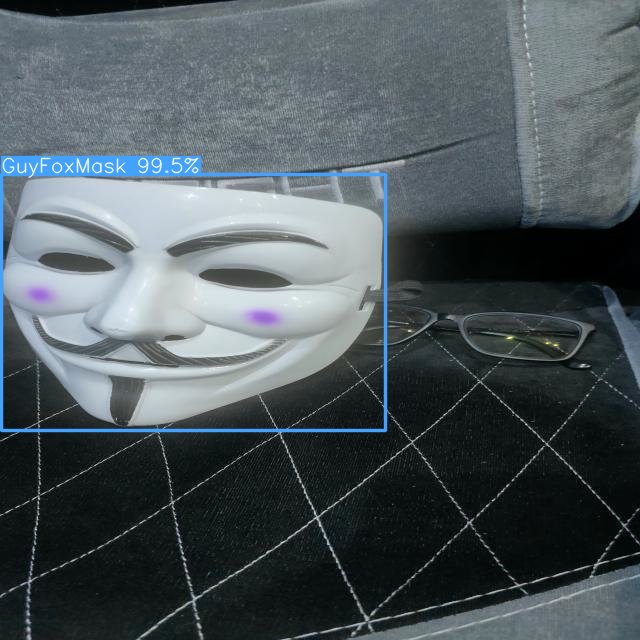

tensor([[  1.00000, 174.00000, 385.00000, 430.00000,   0.99497,   1.00000]], device='cuda:0')
tensor([  1.00000, 174.00000, 385.00000, 430.00000,   0.99497,   1.00000], device='cuda:0')


In [69]:
images_path = os.listdir('GuyFoxMask-Glasses-2/test/images')
model = YOLO('runs/detect/yolov8n_GuyFoxMask_Glasses12/weights/best.pt')
for img in images_path:
  results = model.predict(
      
  source=f'/content/GuyFoxMask-Glasses-2/test/images/{img}')
  #source="/content/GuyFoxMask-Glasses-2/test/images/IMG20230306192726_jpg.rf.3350c113293db86c0ac2d6eff780a1e4.jpg")
  im = imread(f"/content/GuyFoxMask-Glasses-2/test/images/{img}")
  #im = imread("/content/GuyFoxMask-Glasses-2/test/images/IMG20230306192726_jpg.rf.3350c113293db86c0ac2d6eff780a1e4.jpg")
  plot_bboxes(im, results[0].boxes.boxes, score=True)

print(results[0].boxes.boxes)
for i in results[0].boxes.boxes:
  print(i)


yolo-v8-nano:
  - train time 
  - inference ~2.0ms
  - size ~6mb
  - map ~ 0.9


Faster R-CNN:
 - train time 13:37
 - inference ~ 93ms
 - size ~ 314mb
 - map ~ 0.6